In [263]:
import numpy as np
import numba as nb
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 50

import pygad
from scipy.ndimage import rotate
from scipy.ndimage import shift

from matplotlib.animation import FuncAnimation
from IPython.display import HTML

float_type = np.float64

In [264]:
# D2Q9 lattice
d = 2
q = 9

Nx = 200
Ny = 80
N = Nx * Ny

# Lattice Units
dx = 1.
dt = 1.
rho = 1.

# Lattice Coordinates
x = np.arange(Nx)+0.5
y = np.arange(Ny)+0.5
X, Y = np.meshgrid(x,y)

# Paramters
tau = 0.545
u0 = 0.125

omega1 = dt/tau
omega2 = 1-omega1
omega = np.array([omega1, omega2])

SIMULATION_STEPS = 30000

# Lattice velocities & speed of sound
c = np.array([[0,0], [1,0], [0,1], [-1,0], [0,-1], [1,1], [-1, 1], [-1,-1], [1,-1]])
cT = c.T
cs = 1/np.sqrt(3)

directions = np.array([0, 1, 2, 3, 4, 5, 6, 7, 8])
opposite_directions = np.array([0, 3, 4, 1, 2, 7, 8, 5, 6])

# Lattice Weights
w0 = 4./9
w1 = 1./9
w2 = 1./36
w = np.array([w0, w1, w1, w1, w1, w2, w2, w2, w2])

# Equilibrium constants
c1 = 1.0
c2 = 3.0
c3 = 9./2
c4 = -3./2

ceq = np.array([c1, c2, c3, c4])

# Initializing arrays
f = np.zeros((q, Ny, Nx), dtype=float_type)
f_eq = np.zeros((q, Ny, Nx), dtype=float_type)
f_star = np.zeros((q, Ny, Nx), dtype=float_type)
rho = np.ones((Ny, Nx), dtype=float_type)
u = np.zeros((d, Ny, Nx), dtype=float_type)
solution = np.zeros((SIMULATION_STEPS, d+1, Ny, Nx), dtype=float_type)
force = np.zeros((SIMULATION_STEPS, d), dtype=float_type)


# Pre-calculating streaming indexes
indexes = np.zeros((q, Nx * Ny), dtype=int)
for i in range(q):
    xArr = (np.arange(Nx) - c[i][0] + Nx) % Nx
    yArr = (np.arange(Ny) - c[i][1] + Ny) % Ny

    xInd, yInd = np.meshgrid(xArr, yArr)

    indTotal = yInd * Nx + xInd
    indexes[i] = indTotal.reshape(Nx * Ny)


# Pre-calculating solid & solid bounce backs
solid = np.zeros((Ny, Nx), dtype=bool)
boundary_nodes = np.zeros((q, Ny, Nx), dtype=bool)

# Square
# solid = np.where((X > (Nx // 12)) & (X < ((Nx*2)// 12)) & (Y > (Ny // 3)) & (Y < ((Ny*2)// 3)), True, False)

# Circle
# circle_center_x = Nx // 6
# circle_center_y = Ny // 2
# circle_radius = Ny // 6
# distances = np.sqrt((X- circle_center_x)**2 + (Y-circle_center_y)**2)
# solid = np.where((distances < circle_radius), True, False)

# Line
# wall_height = 8
# solid[:, Ny//2] = np.where((Y[:, Ny//2]<int((Ny//2)+wall_height)) & (Y[:, Ny//2]>int((Ny//2)-wall_height)), True, False)

# Elipse
a, b, theta = 12, 7, 16

solid = ((X-Nx//2)**2/(Nx//a)**2) + ((Y-Ny//2)**2/(Ny//b)**2) <= 1
solid = rotate(solid, theta, reshape=False, order=0, mode='constant', cval=0)
solid = shift(solid, shift=(0, -Nx//4), order=0, mode='constant', cval=0)

for i in range(q):
    streamed = np.roll(solid, shift=-c[i, 0], axis=1)
    streamed = np.roll(streamed, shift=-c[i, 1], axis=0)
    boundary_nodes[i] = (streamed==True) & (solid==False)

In [265]:
@nb.njit(fastmath=True, cache=True)
def get_eq(f, rho, u, c, ceq, w, q):
    u2 = (u[0]**2 + u[1]**2)
    for i in range(q):
        cu = (u[0]*c[i, 0] + u[1]*c[i, 1])
        f[i] = w[i]*rho*(ceq[0] + ceq[1]*cu + ceq[2]*cu**2 + ceq[3]*u2)
    return f

@nb.njit(fastmath=True, cache=True)
def set_inlet(f, w, ceq, u0):
    u2 = u0**2
    for i in range(q):
        cu = u0*c[i, 0]
        f[i, :, 0] = w[i]*(ceq[0] + ceq[1]*cu + ceq[2]*cu**2 + ceq[3]*u2)
    return f

def get_macros(f, rho, u, cT, q, N, Ny, Nx):
    rho = np.sum(f, axis=0)
    f_reshaped = f.reshape(q, N)
    u_reshaped = np.dot(cT, f_reshaped)
    u = u_reshaped.reshape(2, Ny, Nx)
    u /= rho
    return rho, u

def collide(f, f_eq, omega):
    return f_eq * omega[0] + f * omega[1]

def stream(f, f_star, Ny, Nx, indexes, q):
    for i in range(q):
        f[i] = f_star[i].reshape(Ny*Nx)[indexes[i]].reshape(Ny, Nx)
    return f

def interior_boundary(f, f_star, boundary_nodes, opposite_directions):
    for i in range(q):
        f[opposite_directions[i]][boundary_nodes[i]] = f_star[i][boundary_nodes[i]]
    return f

def boundary(f, f_star):
    # Bottom Wall
    f[4, -1, :] = f_star[2, -1, :]
    f[8, -1, :] = f_star[6, -1, :]
    f[7, -1, :] = f_star[5, -1, :]

    # Top Wall
    f[2, 0, :] = f_star[4, 0, :]
    f[5, 0, :] = f_star[7, 0, :]
    f[6, 0, :] = f_star[8, 0, :]

    # Right Wall
    f[3, :, -1] = f[3, :, -2]
    f[7, :, -1] = f[7, :, -2]
    f[6, :, -1] = f[6, :, -2]

    return f

def get_force(force, c, f_star, boundary_nodes, opposite_directions, q, step):
    for i in range(q):
        force[step] += c[i] * np.sum(f_star[i][boundary_nodes[i]] + f[opposite_directions[i]][boundary_nodes[i]])
    return force


def run(f, f_eq, f_star, rho, u, u0, c, cT, ceq, w, q, N, Ny, Nx, omega, indexes, boundary_nodes, opposite_directions, SIMULATION_STEPS, solution, force):
    # Initialize distributions (steady flow right)
    u[0] += u0
    f = get_eq(f, rho, u, c, ceq, w, q)

    for i in range(SIMULATION_STEPS):
        rho, u = get_macros(f, rho, u, cT, q, N, Ny, Nx)
        solution[i, 0] = rho
        solution[i, 1:] = u
        f_eq = get_eq(f_eq, rho, u, c, ceq, w, q)
        f_star = collide(f, f_eq, omega)
        f_star = set_inlet(f_star, w, ceq, u0)
        f = stream(f, f_star, Ny, Nx, indexes, q)
        f = interior_boundary(f, f_star, boundary_nodes, opposite_directions)
        f = boundary(f, f_star)
        force = get_force(force, c, f_star, boundary_nodes, opposite_directions, q, i)
    return solution

In [266]:
solution = run(f, f_eq, f_star, rho, u, u0, c, cT, ceq, w, q, N, Ny, Nx, omega, indexes, boundary_nodes, opposite_directions, SIMULATION_STEPS, solution, force)

In [267]:
# np.save(f'cylinder{SIMULATION_STEPS}[20000:22000]-{Nx}-{Ny}.npy', solution[20000:22000])

force: [ 0.1865187  -0.13498438]


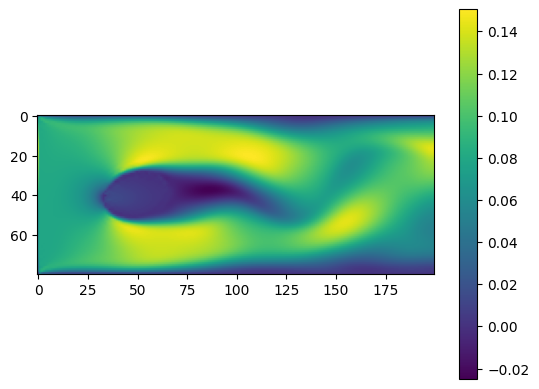

In [268]:
ex = -1
plt.imshow(solution[ex, 1])
plt.colorbar()
print('force:', force[ex])

In [273]:
fig, ax = plt.subplots()
im = ax.imshow(solution[0, 1], animated=True)

skip = 100

def get_frame(frame):
    data = solution[skip*frame, 1]
    im.set_array(data)
    im.set_clim(vmin=data.min(), vmax=data.max())
    return [im]

ani = FuncAnimation(fig, get_frame, frames=290, interval=1, blit=True)

plt.close(fig) 
HTML(ani.to_jshtml())

In [ ]:
def fitness_function(ga_instance, population, population_idx):
    solid = ((X-Nx//2)**2/(Nx/population[0])**2) + ((Y-Ny//2)**2/(Ny//population[1])**2) <= 1
    solid = rotate(solid, population[2], reshape=False, order=0, mode='constant', cval=0)
    solid = shift(solid, shift=(0, -Nx//4), order=0, mode='constant', cval=0)
    pop_f = np.zeros((q, Ny, Nx), dtype=float_type)
    pop_f_eq = np.zeros((q, Ny, Nx), dtype=float_type)
    pop_f_star = np.zeros((q, Ny, Nx), dtype=float_type)
    pop_rho = np.ones((Ny, Nx), dtype=float_type)
    pop_u = np.zeros((d, Ny, Nx), dtype=float_type)
    pop_solution = np.zeros((SIMULATION_STEPS, d+1, Ny, Nx), dtype=float_type)
    pop_force = np.zeros((SIMULATION_STEPS, d), dtype=float_type)
    for i in range(q):
        population_boundary_node = np.zeros((q, Ny, Nx), dtype=bool)
        streamed = np.roll(solid, shift=-c[i, 0], axis=1)
        streamed = np.roll(streamed, shift=-c[i, 1], axis=0)
        population_boundary_node[i] = (streamed==True) & (solid==False)
    pop_solution = run(pop_f, pop_f_eq, pop_f_star, pop_rho, pop_u, u0, c, cT, ceq, w, q, N, Ny, Nx, omega, indexes, population_boundary_node, opposite_directions, SIMULATION_STEPS, pop_solution, pop_force)
    fitness = np.mean(-pop_force[1]/np.abs(pop_force[0]))
    return fitness

sol_per_pop = 20
intial_population = np.zeros((sol_per_pop, 3), dtype=int)
center_x = Nx // 3
center_y = Ny // 2

for i in range(sol_per_pop):
    a = np.random.randint(5, 13)
    b = np.random.randint(5, 13)
    theta = np.random.randint(0, 360)

    intial_population[i] = np.array([a, b, theta])


ga_instance = pygad.GA(
    num_generations=50,
    num_parents_mating=8,
    fitness_func=fitness_function,
    num_genes=3,
    gene_type=float,
    initial_population=intial_population,
    sol_per_pop=sol_per_pop,
    parent_selection_type='tournament',
    K_tournament=4,
    keep_elitism=2,
    crossover_type='scattered',
    crossover_probability=0.9,
    gene_space=[np.arange(4, 13, 1), np.arange(4, 13, 1), np.arange(0, 360, 1)],
    mutation_num_genes=2,
    mutation_type='random'
)

ga_instance.run()

best_solution, best_fitness, _ = ga_instance.best_solution()
optimized_parameters = best_solution
print(f"a=Nx/{optimized_parameters[0]}, b=Ny/{optimized_parameters[1]}, theta={optimized_parameters[2]}")


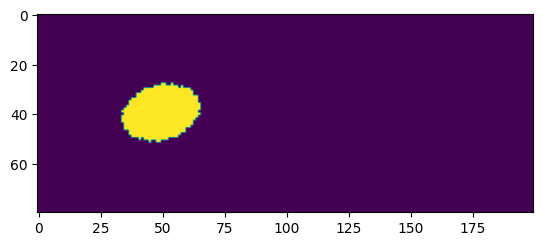

In [ ]:
a, b, theta = optimized_parameters #12, 7, 16

solid = ((X-Nx//2)**2/(Nx//a)**2) + ((Y-Ny//2)**2/(Ny//b)**2) <= 1
solid = rotate(solid, theta, reshape=False, order=0, mode='constant', cval=0)
solid = shift(solid, shift=(0, -Nx//4), order=0, mode='constant', cval=0)

plt.imshow(solid)

In [ ]:
a, b, theta = intial_population[0]

solid = ((X-Nx//2)**2/(Nx/a)**2) + ((Y-Ny//2)**2/(Ny//b)**2) <= 1
solid = rotate(solid, theta, reshape=False, order=0, mode='constant', cval=0)
solid = shift(solid, shift=(0, -Nx//4), order=0, mode='constant', cval=0)

plt.imshow(solid)